In [1]:
import numpy as np

def levenshtein(seq1, seq2):
    size_x = len(seq1) + 1
    size_y = len(seq2) + 1
    matrix = np.zeros ((size_x, size_y))
    for x in range(size_x):
        matrix [x, 0] = x
    for y in range(size_y):
        matrix [0, y] = y

    for x in range(1, size_x):
        for y in range(1, size_y):
            if seq1[x-1] == seq2[y-1]:
                matrix [x,y] = min(
                    matrix[x-1, y] + 1,
                    matrix[x-1, y-1],
                    matrix[x, y-1] + 1
                )
            else:
                matrix [x,y] = min(
                    matrix[x-1,y] + 1,
                    matrix[x-1,y-1] + 1,
                    matrix[x,y-1] + 1
                )
    #print (matrix)
    return (matrix[size_x - 1, size_y - 1])

In [2]:
import pandas as pd
df0 = pd.read_csv('ex_lan6.csv',delimiter=';',encoding='latin')

In [4]:
df0.head()

,FR,EN,DE,ES,CT,IT,RU,PL,UK,AZ,...,MK,LA,EU,WA,ML,LU,IS,IR,OC,PB
0,maison,House,Haus,casa,casa,casa,dom,dom,Budynok,Ev,...,Kuka,domum,Etxea,ty,Dar,Haus,Hus,Teach,ostal,casa
1,ville,city,Stadt,ciudad,ciutat,citta,gorod,miasto,misto,sahar,...,grad,urbs,hiri,ddinas,belt,Stad,borg,cathrach,ciutat,cite
2,porte,door,Tur,puerta,porta,porta,dver,drzwi,dveri,qapi,...,vrata,ianua,ate,drws,bieb,Dier,hurdh,doras,porta,porta
3,route,road,Strasse,carretera,carretera,strada,doroga,droga,doroha,Yol,...,pat,via,errepide,ffordd,fit triq,Strooss,vegur,bothar,rota,via
4,homme,man,Mann,hombre,home,uomo,chelovek,mezczyzna,lyudyna,adam,...,Covek,vir,gizon,dyn,ragel,Mann,madhur,fear,ome,omo


In [196]:
df = df0[['RU','IS','LA','GR','IT','CT','ES','GA','PT','RO','OC','FR','EN','NL','LU','DE','DN','NO','SW','LT','LV','EE','FI','HU','SK','CZ','PL','UK','BU','MK','SR','HR','BH','SV']]

In [239]:
df = df0[['RU','IS','LA','IT','CT','ES','GA','PT','RO','OC','FR','EN','NL','LU','DE','DN','NO','SW','EE','FI','HU','SK','CZ','PL','UK','BU','MK','SR','HR','BH','SV']]

In [3]:
df = df0[['RU','IS','LA','IT','CT','ES','GA','PT','RO','OC','FR','EN','NL','LU','DE','DN','NO','SW','SK','CZ','PL','UK','BU','MK','SR','HR','BH','SV','EE','FI','HU']]

In [4]:
def comp(l1, l2) :
    dl = 0
    for index, row in df.iterrows(): 
        dl += levenshtein(row[l1],row[l2])
    return (df.columns[l1], df.columns[l2], dl)

In [5]:
df.shape

(94, 31)

In [6]:
colname = df.columns

In [7]:
dis_lang = pd.DataFrame(index=colname, columns=colname)

for i in range(0,len(df.columns)) :
    for j in range(0,len(df.columns)):
        r = comp(i,j)
        dis_lang[r[0]][r[1]] = r[2]

In [8]:
dis_lang

,RU,IS,LA,IT,CT,ES,GA,PT,RO,OC,...,UK,BU,MK,SR,HR,BH,SV,EE,FI,HU
RU,0,687,658,659,643,669,646,668,656,637,...,410,488,496,499,514,488,513,646,701,673
IS,687,0,602,617,584,632,589,618,587,577,...,642,618,591,587,595,586,609,567,607,613
LA,658,602,0,490,478,507,478,501,506,461,...,639,592,562,557,566,554,564,580,611,594
IT,659,617,490,0,361,387,355,384,489,337,...,645,614,581,565,582,576,597,580,639,611
CT,643,584,478,361,0,292,263,347,461,250,...,637,586,561,554,549,556,563,557,592,577
ES,669,632,507,387,292,0,233,316,498,366,...,667,621,599,592,581,591,610,593,627,619
GA,646,589,478,355,263,233,0,277,462,354,...,640,604,572,565,568,556,573,572,607,589
PT,668,618,501,384,347,316,277,0,507,388,...,670,622,588,581,579,583,591,588,609,601
RO,656,587,506,489,461,498,462,507,0,459,...,645,589,569,560,570,559,576,558,604,586
OC,637,577,461,337,250,366,354,388,459,0,...,624,589,547,532,551,536,560,557,586,559


In [9]:
lang_coord = pd.DataFrame(index=colname, columns=['x','y'])
for index, row in lang_coord.iterrows(): 
    row['x'] = np.random.random_sample()
    row['y'] = np.random.random_sample()

In [10]:
colors = pd.read_csv('colors.csv',delimiter=';',encoding='latin')

In [11]:
lang_coord_2 = pd.merge(lang_coord, colors, right_on = "lan", left_index = True)
lang_coord = lang_coord_2.set_index('lan')

In [12]:
lang_coord

,x,y,color
lan,,,
RU,0.383637,0.337534,#FF4280
IS,0.021524,0.220864,#10107F
LA,0.718367,0.333715,#4C9F85
IT,0.602335,0.690159,#4C9F85
CT,0.0278946,0.469446,#579A65
ES,0.275253,0.885969,#58956E
GA,0.984259,0.582391,#5A9273
PT,0.0756789,0.0718868,#69AC6B
RO,0.455693,0.641698,#5FB875


In [13]:
from math import *
dis_lang_obt = pd.DataFrame(index=colname, columns=colname)

for i in range(0,len(lang_coord.index)) :
    for j in range(0,len(lang_coord.index)):
        d = sqrt((lang_coord['x'][i]-(lang_coord['x'][j]))**2+(lang_coord['y'][i]-(lang_coord['y'][j]))**2)
        dis_lang_obt[lang_coord.index[i]][lang_coord.index[j]] = d
dis_lang_obt.head()

,RU,IS,LA,IT,CT,ES,GA,PT,RO,OC,...,UK,BU,MK,SR,HR,BH,SV,EE,FI,HU
RU,0,0.380444,0.334752,0.414938,0.379412,0.559042,0.648615,0.406702,0.312582,0.576142,...,0.314767,0.60871,0.52586,0.227888,0.371677,0.244799,0.835989,0.435408,0.396631,0.308806
IS,0.380444,0,0.705922,0.746712,0.248664,0.711858,1.02838,0.158515,0.604651,0.686,...,0.530457,0.983854,0.649897,0.400016,0.750579,0.530575,1.17768,0.814756,0.377015,0.288552
LA,0.334752,0.705922,0,0.374855,0.703687,0.70805,0.364058,0.693976,0.404785,0.755997,...,0.337207,0.278433,0.706719,0.49186,0.162066,0.394043,0.670851,0.130787,0.688698,0.537959
IT,0.414938,0.746712,0.374855,0,0.615383,0.381214,0.396838,0.812174,0.154442,0.446915,...,0.637963,0.485191,0.406609,0.367347,0.227197,0.220075,0.43107,0.334758,0.530814,0.722108
CT,0.379412,0.248664,0.703687,0.615383,0,0.484435,0.963011,0.400421,0.461174,0.448072,...,0.646812,0.964167,0.417801,0.250254,0.692553,0.399313,1.03178,0.78292,0.134492,0.473622


In [14]:
dis_lang = dis_lang.astype("float32")
dis_lang_obt = dis_lang_obt.astype("float32")
lang_coord = lang_coord[['x','y']].astype("float32")

In [51]:
lang_coord.index

Index(['RU', 'IS', 'LA', 'IT', 'CT', 'ES', 'GA', 'PT', 'RO', 'OC', 'FR', 'EN',
       'NL', 'LU', 'DE', 'DN', 'NO', 'SW', 'SK', 'CZ', 'PL', 'UK', 'BU', 'MK',
       'SR', 'HR', 'BH', 'SV', 'EE', 'FI', 'HU'],
      dtype='object', name='lan')

In [15]:
import statistics as st

In [16]:
c1 = st.mean(dis_lang.corrwith(dis_lang_obt))
d1 = min(dis_lang.corrwith(dis_lang_obt))

In [17]:
c1

0.2979062912059968

In [18]:
from IPython.display import display, clear_output
import sys
from sty import fg, Style, RgbFg

In [21]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import numpy as np

def getImage(path):
    return OffsetImage(plt.imread(path))

In [22]:
lang_coord_test = lang_coord.copy()

76.2281 (46.027) - 99.96
RU
IS
LA
IT
CT
ES
GA
PT
RO
OC
FR
EN
NL
LU
DE
DN
NO
SW
SK
CZ
PL
UK
BU
MK
SR
HR
BH
SV
EE
FI
HU
31
fini : 0.7622808436857271


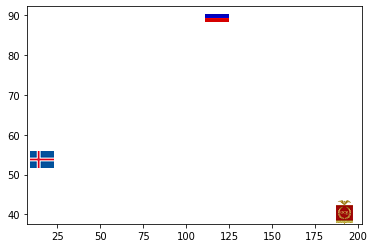

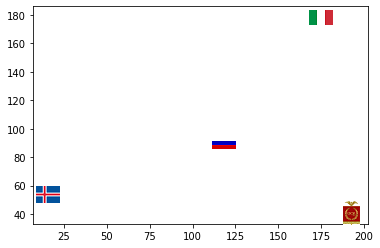

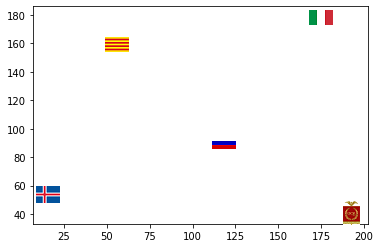

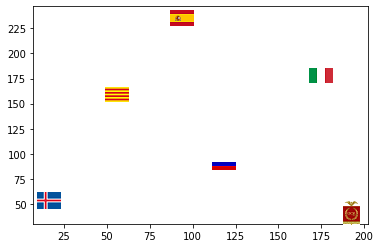

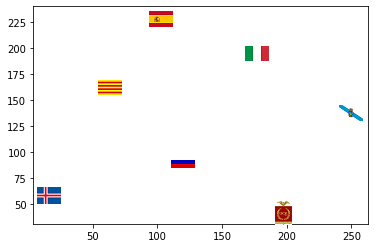

...

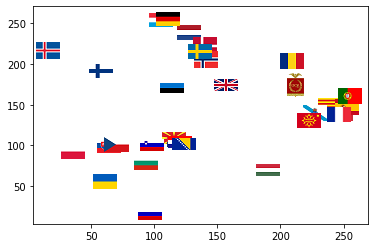

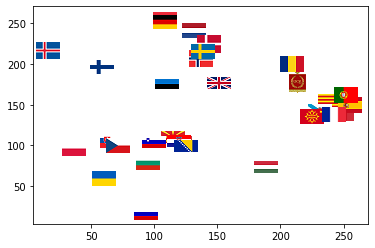

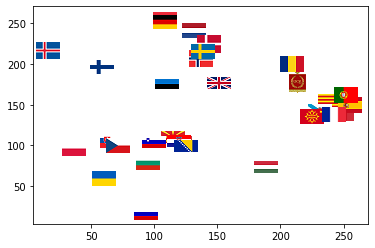

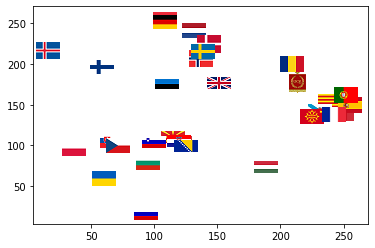

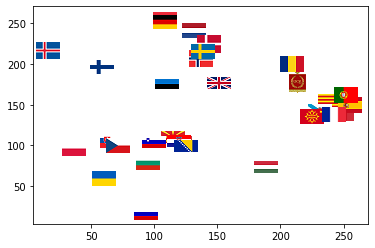

In [26]:
p = 0.025
t = 0.75
ep = 2500

c1 = st.mean(dis_lang.corrwith(dis_lang_obt))
d1 = min(dis_lang.corrwith(dis_lang_obt))
dis_lang_obt_test = dis_lang_obt.copy()

l = 3

for x in range (0,ep) :
                
    c1 = st.mean(dis_lang.iloc[:l,:l].corrwith(dis_lang_obt.iloc[:l,:l]))
    d1 = min(dis_lang.iloc[:l,:l].corrwith(dis_lang_obt.iloc[:l,:l]))

    for index, row in lang_coord_test.iloc[:l,:l].iterrows(): 
        row['x'] = np.random.normal(row['x'], p, 1)[0]
        row['y'] = np.random.normal(row['y'], p, 1)[0]

    for i in range(0,len(lang_coord_test.index)) :
        for j in range(0,len(lang_coord_test.index)):
            d = sqrt((lang_coord_test['x'][i]-(lang_coord_test['x'][j]))**2+(lang_coord_test['y'][i]-(lang_coord_test['y'][j]))**2)
            dis_lang_obt_test[lang_coord_test.index[i]][lang_coord_test.index[j]] = d

    #dfL2test = dfL2.iloc[:n,:n]
    
    dis_lang_obt = dis_lang_obt.astype("float32")
    
    c2 = st.mean(dis_lang.iloc[:l,:l].corrwith(dis_lang_obt_test.iloc[:l,:l]))
    d2 = min(dis_lang.iloc[:l,:l].corrwith(dis_lang_obt_test.iloc[:l,:l]))

    if c2 > c1 :
        lang_coord = lang_coord_test.copy()
        dis_lang_obt = dis_lang_obt_test.copy()
        c1 = c2
        d1 = d2
    else :
        lang_coord_test = lang_coord.copy()
        dis_lang_obt_test = dis_lang_obt.copy()
    
    #Affichage avancemment
    sys.stdout.flush()
    clear_output(wait=True)
    print(str(round(c1*100,4))+" ("+str(round(d1*100,4))+") - "+str(x/(ep/100)))
    
    #Creation des graphes
    fig = plt.figure()
    ax = fig.add_subplot()
    
    #Representation couleurs
    RGB = (lang_coord - lang_coord.min()) / (lang_coord.max() - lang_coord.min())*239+16
    RGB = pd.merge(RGB, colors, right_on = "lan", left_index = True).set_index('lan')
    RGB = RGB.iloc[:l,:l]
    for index, row in RGB.iterrows(): 
        fg.color = Style(RgbFg(int(row['x']), int(row['y']), 128))
        buf = fg.color + row.name + fg.rs
        print(buf, sep='\n')
        xs = row['x']
        ys = row['y']
        n = row.name
        ax.scatter(xs, ys)
        ab = AnnotationBbox(getImage('ex_img/'+n+'.png'), (xs, ys), frameon=False)
        ax.add_artist(ab)
        #ax.text(xs+0.01, ys+0.01, n, fontsize=9)
    
    if(c1==c2) :
        plt.savefig('img/flg/'+str(x)+'.png',dpi=400)

    if(c1 > t) :
        l += 1
        
    l = min(31,l)
    print(l)

print("fini : "+str(c1))